In [1]:
import warnings
import intake
import xarray as xr 
import matplotlib.pyplot as plt 
import pandas as pd 
import cftime
import gcsfs
import cartopy.crs as ccrs
from pathlib import Path
import pandas as pd
from a448_lib import data_read
import fsspec
import cmocean as cm
import cartopy.feature as cfeature
import numpy as np
import plotly.graph_objects as go
import cartopy.feature as cf

In [2]:
csv_filename = "pangeo-cmip6.csv"
root = "https://storage.googleapis.com/cmip6"
if Path(csv_filename).is_file():
    print(f"found {csv_filename}")
else:
    print(f"downloading {csv_filename}")
    data_read.download(csv_filename,root=root)
    
json_filename="https://storage.googleapis.com/cmip6/pangeo-cmip6.json"

found pangeo-cmip6.csv


* make a dataframe from the csv version

In [3]:
catalog_df=pd.read_csv(csv_filename)
catalog_df.head()

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
0,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,tauv,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
1,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rsut,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
2,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,6hrPlev,psl,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
3,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,clt,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
4,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,evspsbl,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706


* make an intake collection from the json version

In [4]:
# Getting the esm_datastore
col = intake.open_esm_datastore(json_filename)

In [5]:
def get_models_with_var(data_store, var_id, table_id):
    '''Takes a variable id and a corresponding table id and and returns all the model labels 
       with the combination '''
    query_variable_id = dict(
        experiment_id=['historical'],
        table_id = [table_id],
        variable_id=[var_id])

    data_sets = col.search(**query_variable_id)
    return(data_sets.df.source_id.unique())

In [6]:
# Creating dictionary to map names of model variables to full names, associated tables, and units
var_key = {
    'tas' : 
        {'fullname' : 'Near-Surface Air Temperature',
         'monthly_table' : 'Amon',
         'units' : '[K]'},
    'ta' :
        {'fullname' : 'Air Temperature',
         'monthly_table' : 'Amon',
         'units' : '[K]'},
    'pr' : 
        {'fullname' : 'Precipitation',
         'monthly_table' : 'Amon',
         'units' : '[kg m-2 s-1]'},
    'hus' : 
        {'fullname' : 'Specific Humidity',
         'monthly_table' : 'Amon' ,
         'units' : '[1]'}, 
    'cl' : 
        {'fullname' : 'Percentage Cloud Cover',
         'monthly_table' : 'Amon',
         'units' : '[%]'},
    'sisnthick' :
        {'fullname' : 'Snow Thickness',
         'monthly_table' : 'SImon',
         'units' : '[m]'},
    'sithick' :  
        {'fullname' : 'Sea Ice Thickness',
         'monthly_table' : 'SImon',
         'units' : '[m]'},
    'mrro' : 
        {'fullname' : 'Total Runoff', 
         'monthly_table' : 'Lmon',
         'units' : '[kg m-2 s-1]'},
    'lai' : 
        {'fullname' : 'Leaf Area Index',
         'monthly_table' : 'Lmon',
         'units' : '[1]'}, 
    'mrso' : {'fullname' : 'Total Soil Moisture Content' ,
              'monthly_table' : 'Lmon',
              'units' : '[kg m-2]'}
}

In [7]:
def get_monthly_table_for_var(var_id):
    '''Returns appropriate X-mon for a given variable id from
       the var key'''
    return var_key[var_id]['monthly_table']
    

In [8]:
def get_outline():
    """returns a plotly figure with cartopy's coastline geometries on it"""
    x_coords = []
    y_coords = []
    for coord_seq in cf.COASTLINE.geometries():
        x_coords.extend([k[0] for k in coord_seq.coords] + [np.nan])
        y_coords.extend([k[1] for k in coord_seq.coords] + [np.nan])

    # in your app callback for dash
    fig = go.Figure()
    fig.add_trace(
        go.Scatter(
            x = x_coords,
            y = y_coords,
            mode = 'lines'))
    return fig

In [9]:
def get_cmpi6_model_run(data_store, var_id, mod_id):
    """ Queries a given data store for historical model runs for the given variable id

    Wraps a query for the data_store using variable and model id from the associated monthly
    table. Takes the first model run from the historical experiments. Variable id must be supported by
    get_monthly_table_for_var(). 

    Parameters
    ----------
    data_store : esm_datastore
        The data store to extract the variable and model id's from
    var_id : string
        String to search for. Table id will be fetched with get_monthly_table_for_var(var_id)
    mod_id : string
        The climate model string to use in query. If the model does not provide var function
        will fail mysteriously and inelegantly- get_models_with_var() may help.

    Returns
    -------
    dset_opened : xarray.Datasfet
        The xarray object matching the query
    """
    
    # Querying datastore to get xarr file
    query_variable_id = dict(
        experiment_id=['historical'],
        source_id = mod_id,
        table_id = [get_monthly_table_for_var(var_id)],
        variable_id=[var_id])

    datasets = data_store.search(**query_variable_id)

    # Getting the member number for the first experiment
    first_member_id = datasets.df['member_id'][0]

    dstore_filename = datasets.df.query("member_id==@first_member_id")['zstore'].iloc[0]

    dset_opened = xr.open_zarr(fsspec.get_mapper(dstore_filename), consolidated=True)

    return dset_opened

In [10]:
def plot_year(dset, var_id, month, year, layer = 1):
    """ This function plots results for a given month and year for a variable given by var_id in the dset 

    Wraps matplotlib plotting code for a one month, year slice of cmpi-6 climate model output for the given variable
    on a Plate Caree projection. Specifies var_id as title and caption for legend.

    Parameters
    ----------
    dset : xarray.Dataset
        The xarray.Dataset to plot
    var_id : 'str'
        The variable to be plotted.
    month : 'str'
        String specifying which month to plot.
        Must be between '01'-'12'. 0 required for single digit months.
    year : 'str'
        Year to plot. Must be between '1850' and '2014'
    layer : int
        Must be between 0 and 18- only used for plotting humidity and temp
        
    Returns
    -------
    None
    """
    # Specifying a year and month to select by with xarray
    start_date = year + '-' + month + '-' + '14'
    end_date = year + '-' + month + '-' + '17'

    lon = dset.lon
    lat = dset.lat
   
    # Slicing model output on the given times two ways depending on whether or not the model has layers
    layer_vars = ['hus', 'ta']
    if var_id in layer_vars:
        var_data = dset[var_id].sel(time=slice(start_date, end_date))[0, layer,:,:]
    else:
        var_data = dset[var_id].sel(time=slice(start_date, end_date))[0,:,:]
    
    # Plotting the variables, setting label and title to variable id
    f, ax = plt.subplots(1,1,figsize=(12,12),
                     subplot_kw=dict(projection=ccrs.PlateCarree()))

    p = ax.pcolormesh(lon,
              lat,
              var_data,
              transform=ccrs.PlateCarree())

    f.colorbar(p, label= var_key[var_id]['units'], shrink = .5)
    ax.set_title(var_key[var_id]['fullname'] + ' ' + year + '-' + month)

    # Add land.
    ax.add_feature(cfeature.LAND, color='#a9a9a9', zorder = 4, alpha = .1)

In [41]:
def plot_year_plotly(dset, var_id, month, year, layer = 1):
    """ This function plots results for a given month and year for a variable given by var_id in the dset 

    Wraps plotly plotting code for a one month, year slice of cmpi-6 climate model output for the given variable

    Parameters
    ----------
    dset : xarray.Dataset
        The xarray.Dataset to plot
    var_id : 'str'
        The variable to be plotted.
    month : 'str'
        String specifying which month to plot.
        Must be between '01'-'12'. 0 required for single digit months.
    year : 'str'
        Year to plot. Must be between '1850' and '2014'
    layer : int
        Must be between 0 and 18- only used for plotting humidity and temp
        
    Returns
    -------
    fig : plotly figure object
    """
    # Specifying a year and month to select by with xarray
    start_date = year + '-' + month + '-' + '14'
    end_date = year + '-' + month + '-' + '17'

    lon = dset.lon
    lat = dset.lat
   
    # Slicing model output on the given times two ways depending on whether or not the model has layers
    layer_vars = ['hus', 'ta']
    if var_id in layer_vars:
        var_data = dset[var_id].sel(time=slice(start_date, end_date))[0, layer,:,:]
    else:
        var_data = dset[var_id].sel(time=slice(start_date, end_date))[0,:,:]
    
    # Converting to a df so we can use plotly
    var_df = var_data.to_dataframe().reset_index()
    
    # Converting from a 0-360 longitudinal system to a -180-180 longitudinal system
    var_df['lon_adj'] = var_df['lon'].apply(lambda x: x - 360 if x > 180 else x)
    
    # Plotting
    fig = get_outline()
   
    fig.add_trace(
        go.Contour(
               x = var_df['lon_adj'],
               y = var_df['lat'],
               z = var_df[var_id],
               contours_coloring='heatmap',
               colorbar= {
               "borderwidth": 0, 
                "outlinewidth": 0, 
                "thickness": 15, 
                "tickfont": {"size": 14}, 
                "title": var_key[var_id]['units']}, #gives your legend some units                                                                     

                contours= {
                #"end": 4, 
                "showlines": False, 
                #"size": 0.5, #this is your contour interval
                #"start": -4 
                }))
    fig.update_layout(margin={"r":1,"t":4,"l":1,"b":1},
                     title = var_key[var_id]['fullname'] + ' ' + year + '-' + month)

    return fig

In [42]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'lai', mod_id = 'GFDL-CM4')
dset = dset['lai'].sel(time=slice('1900-01-14', '1900-01-17'))
var_df = dset.to_dataframe().reset_index()
var_df.to_csv('leaf_1900.csv')

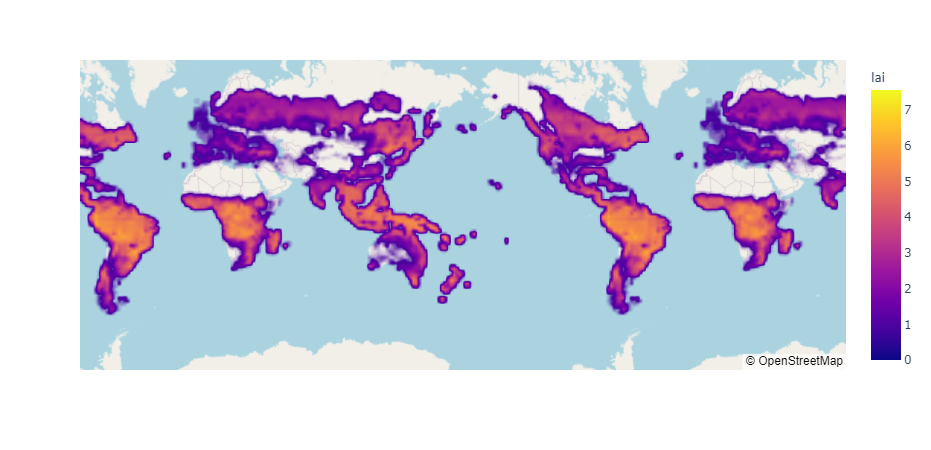

In [43]:
# Experimenting with the density_mapbox option
import plotly.express as px
fig = px.density_mapbox(var_df, lat='lat', lon='lon', z='lai', radius=3,
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

In [44]:
# Attempting to use the scatter mapbox for the graph. It doesn't look terrible but things fall apart when you zoom in.
#fig = px.scatter_mapbox(var_df, lat='lat', lon='lon', color='lai', 
#                        center=dict(lat=0, lon=180), zoom=0,
#                        mapbox_style="open-street-map")
#fig.show()

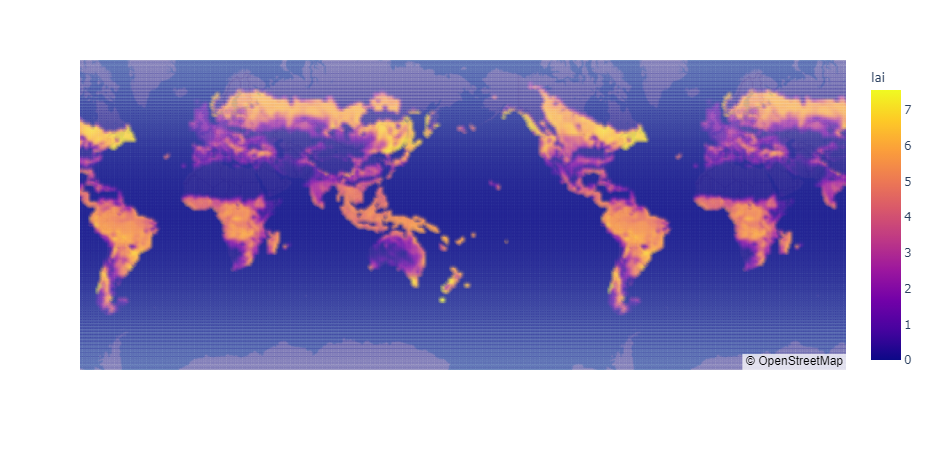

In [45]:
# Attempting to use the scatter mapbox for the graph. It doesn't look terrible but things fall apart when you zoom in.
fig = px.scatter_mapbox(var_df, lat='lat', lon='lon', color='lai', 
                        center=dict(lat=0, lon=180), zoom=0, opacity = .2,
                        mapbox_style="open-street-map")
fig.show()

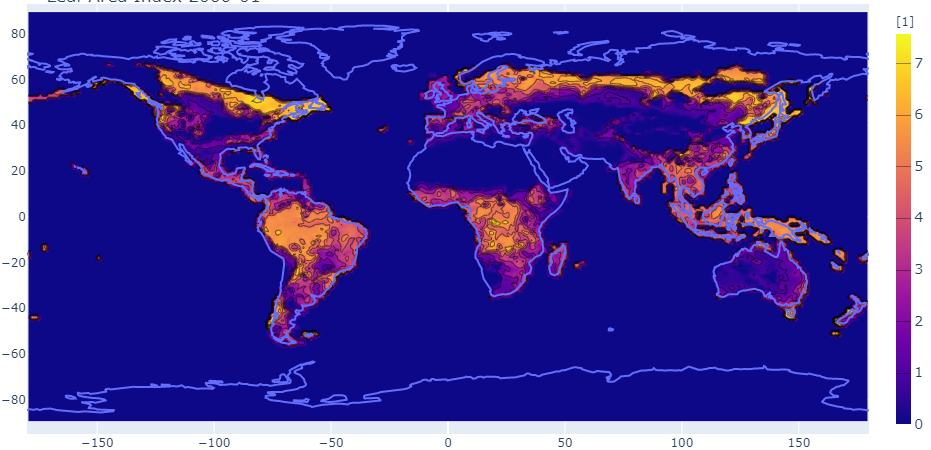

In [46]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'lai', mod_id = 'GFDL-CM4')
fig = plot_year_plotly(dset, var_id = 'lai', month = '01', year = '2000', layer = 4)
fig

In [47]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'lai', mod_id = 'GFDL-CM4')
fig = plot_year_plotly(dset, var_id = 'lai', month = '01', year = '2000', layer = 4)

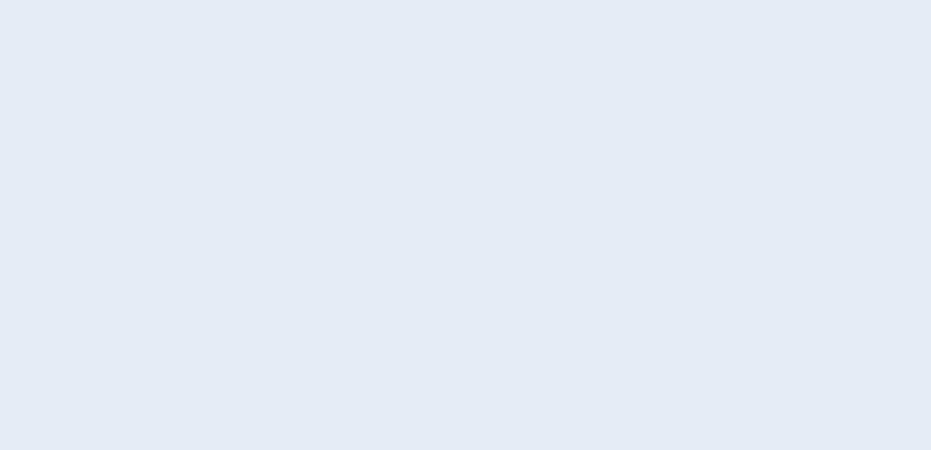

In [51]:
# Trying to use old matplotlib plot as background to get plotly zooming ability. 
# Did not work particularly well
# Create figure
fig = go.Figure()

# Constants
img_width = 1600
img_height = 900
scale_factor = 0.5

# Add invisible scatter trace.
# This trace is added to help the autoresize logic work.
fig.add_trace(
    go.Scatter(
        x=[0, img_width * scale_factor],
        y=[0, img_height * scale_factor],
        mode="markers",
        marker_opacity=0
    )
)

# Configure axes
fig.update_xaxes(
    visible=False,
    range=[0, img_width * scale_factor]
)

fig.update_yaxes(
    visible=False,
    range=[0, img_height * scale_factor],
    # the scaleanchor attribute ensures that the aspect ratio stays constant
    scaleanchor="x"
)

# Add image
fig.add_layout_image(
    dict(
        x=0,
        sizex=img_width * scale_factor,
        y=img_height * scale_factor,
        sizey=img_height * scale_factor,
        xref="x",
        yref="y",
        opacity=1.0,
        layer="below",
        sizing="stretch",
        source="https://raw.githubusercontent.com/JacobMcFarlane/cmpi_6_dash/master/test_plotly_background.PNG?token=APLR3SLPZUHP2WK5VEBKHQLAORHJM")
)

# Configure other layout
fig.update_layout(
    width=img_width * scale_factor,
    height=img_height * scale_factor,
    margin={"l": 0, "r": 0, "t": 0, "b": 0},
)

# Disable the autosize on double click because it adds unwanted margins around the image
# More detail: https://plotly.com/python/configuration-options/
fig.show(config={'doubleClick': 'reset'})

In [49]:
def plotly_wrapper(var_id = 'tas', mod_id = 'GFDL-CM4', month = '01', year = '1950', layer = 1):
    dset = get_cmpi6_model_run(col, var_id, mod_id)
    fig = plot_year_plotly(dset, var_id, month, year, layer)
    return fig

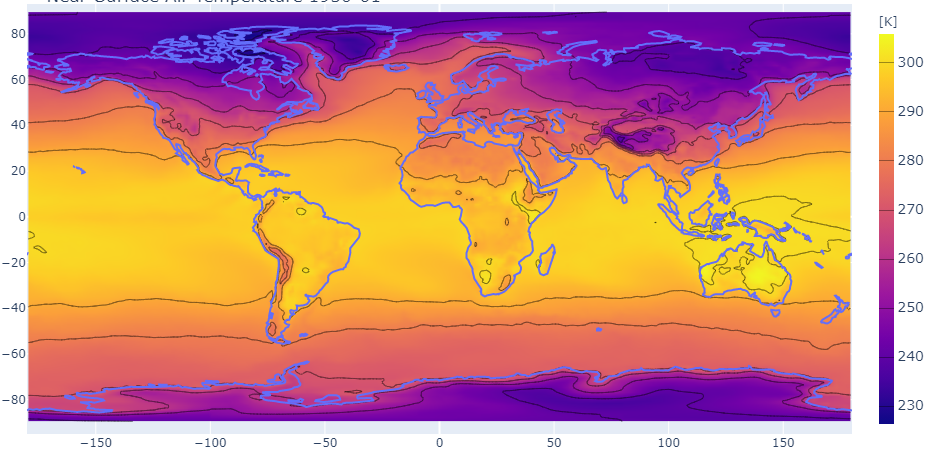

In [50]:
plotly_wrapper()

In [22]:
def plot_wrapper(var_id = 'tas', mod_id = 'GFDL-CM4', month = '01', year = '1950', layer = 1):
    dset = get_cmpi6_model_run(col, var_id, mod_id)
    plot_year(dset, var_id, month, year, layer)

In [23]:
var_key['mrro']

{'fullname': 'Total Runoff', 'monthly_table': 'Lmon', 'units': '[kg m-2 s-1]'}

In [24]:
get_models_with_var(col, 'mrro', 'Lmon')

array(['GFDL-CM4', 'IPSL-CM6A-LR', 'CNRM-CM6-1', 'GISS-E2-1-G',
       'BCC-CSM2-MR', 'BCC-ESM1', 'CNRM-ESM2-1', 'MIROC6', 'CESM2-WACCM',
       'CanESM5', 'CESM2', 'SAM0-UNICON', 'GISS-E2-1-H', 'UKESM1-0-LL',
       'CanESM5-CanOE', 'INM-CM4-8', 'MRI-ESM2-0', 'EC-Earth3-Veg',
       'HadGEM3-GC31-LL', 'EC-Earth3', 'MPI-ESM-1-2-HAM', 'INM-CM5-0',
       'MPI-ESM1-2-LR', 'MPI-ESM1-2-HR', 'GFDL-ESM4', 'MCM-UA-1-0',
       'GISS-E2-1-G-CC', 'MIROC-ES2L', 'CAMS-CSM1-0', 'KACE-1-0-G',
       'E3SM-1-0', 'NorESM2-LM', 'ACCESS-CM2', 'ACCESS-ESM1-5',
       'CESM2-WACCM-FV2', 'FIO-ESM-2-0', 'HadGEM3-GC31-MM',
       'E3SM-1-1-ECA', 'TaiESM1'], dtype=object)

In [25]:
var_key

{'tas': {'fullname': 'Near-Surface Air Temperature',
  'monthly_table': 'Amon',
  'units': '[K]'},
 'ta': {'fullname': 'Air Temperature',
  'monthly_table': 'Amon',
  'units': '[K]'},
 'pr': {'fullname': 'Precipitation',
  'monthly_table': 'Amon',
  'units': '[kg m-2 s-1]'},
 'hus': {'fullname': 'Specific Humidity',
  'monthly_table': 'Amon',
  'units': '[1]'},
 'cl': {'fullname': 'Percentage Cloud Cover',
  'monthly_table': 'Amon',
  'units': '[%]'},
 'sisnthick': {'fullname': 'Snow Thickness',
  'monthly_table': 'SImon',
  'units': '[m]'},
 'sithick': {'fullname': 'Sea Ice Thickness',
  'monthly_table': 'SImon',
  'units': '[m]'},
 'mrro': {'fullname': 'Total Runoff',
  'monthly_table': 'Lmon',
  'units': '[kg m-2 s-1]'},
 'lai': {'fullname': 'Leaf Area Index',
  'monthly_table': 'Lmon',
  'units': '[1]'},
 'mrso': {'fullname': 'Total Soil Moisture Content',
  'monthly_table': 'Lmon',
  'units': '[kg m-2]'}}

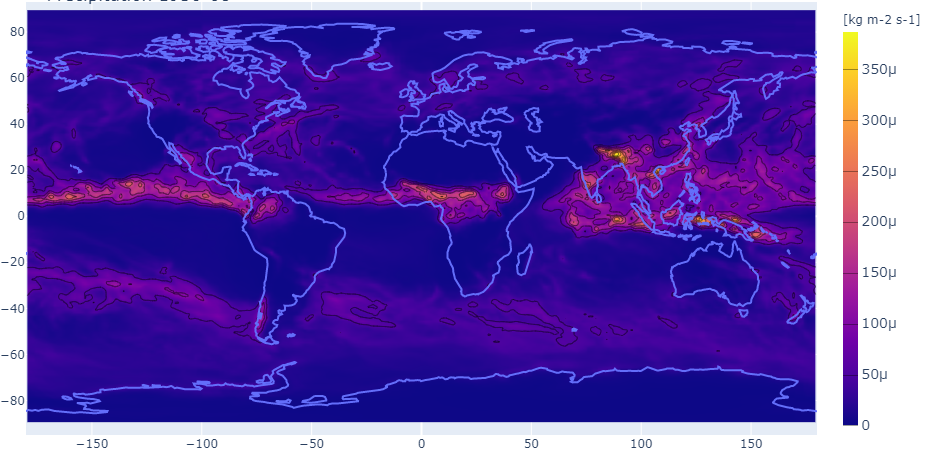

In [26]:
plotly_wrapper(var_id = 'pr', month = '08')

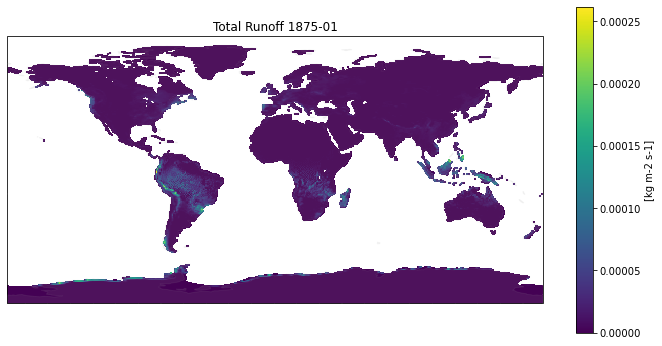

In [27]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'mrro', mod_id = 'EC-Earth3')
plot_year(dset, var_id = 'mrro', month = '01', year = '1875', layer = 4)

In [28]:
from keplergl import KeplerGl
map_1 = KeplerGl()
map_1

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl()

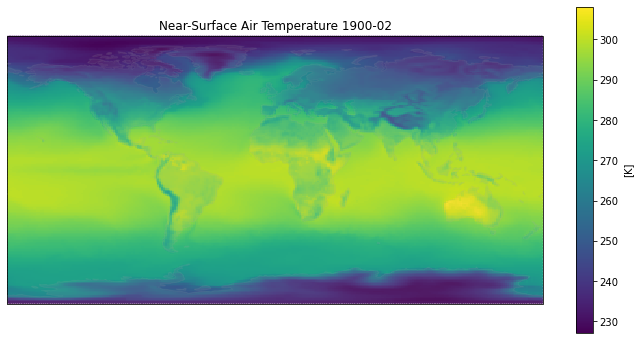

In [29]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'tas', mod_id = 'GFDL-CM4')
plot_year(dset, var_id = 'tas', month = '02', year = '1900', layer = 4)

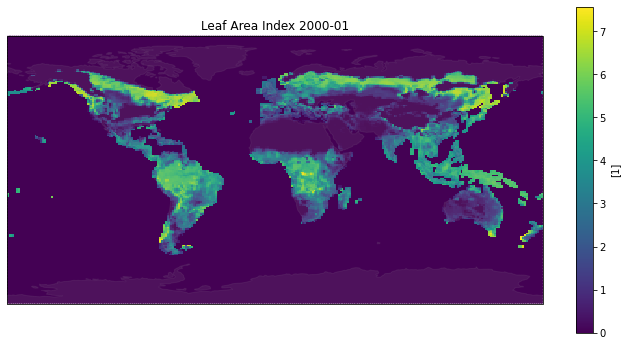

In [30]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'lai', mod_id = 'GFDL-CM4')
plot_year(dset, var_id = 'lai', month = '01', year = '2000', layer = 4)

Using the above to plot precipitation

In [31]:
# pr is Precipitation [kg m-2 s-1] 
# Does this mean precipitation in kilograms per meter squared?
dset = get_cmpi6_model_run(data_store = col, var_id = 'pr', mod_id = 'GFDL-CM4')

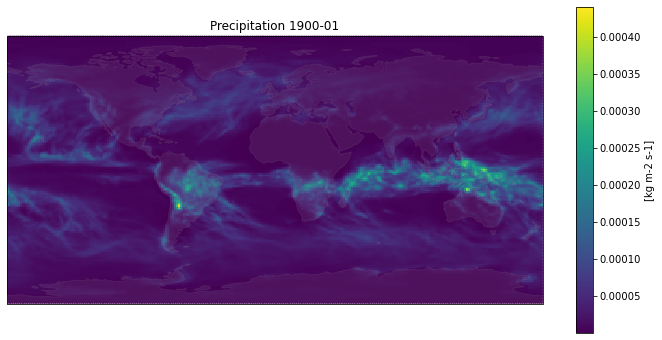

In [32]:
plot_year(dset, var_id = 'pr', month = '01', year = '1900')

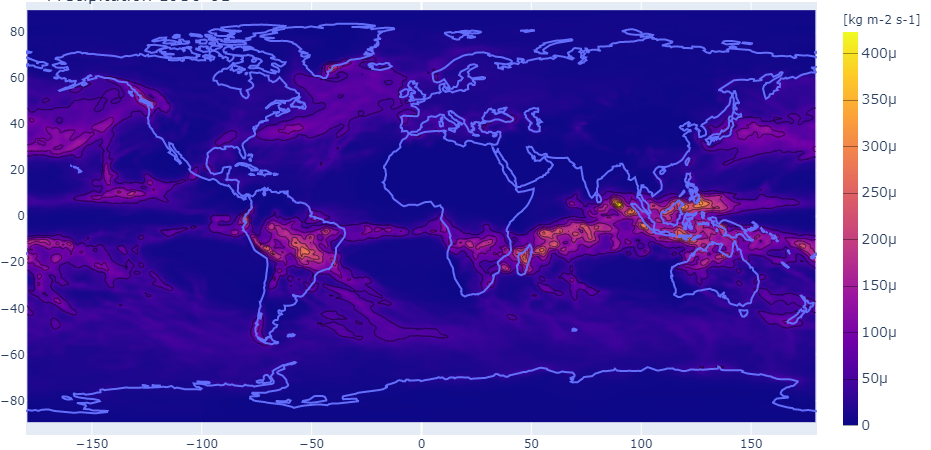

In [33]:
plotly_wrapper(var_id = 'pr', mod_id = 'GFDL-CM4', month = '01', year = '1950', layer = 1)

Using the functions to plot surface temperature in Kelvin

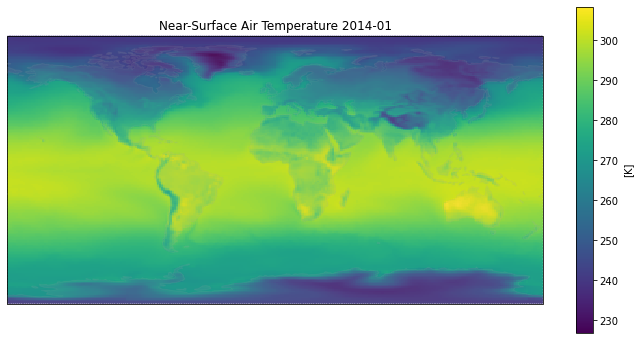

In [34]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'tas', mod_id = 'GFDL-CM4')
plot_year(dset, var_id = 'tas', month = '01', year = '2014')

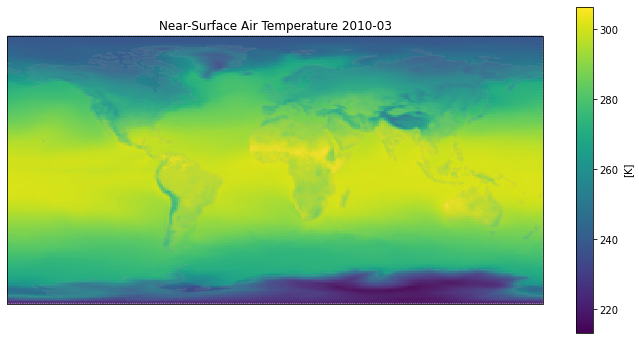

In [35]:
plot_year(dset, var_id = 'tas', month = '03', year = '2010')

Plotting specific humdity at various layers

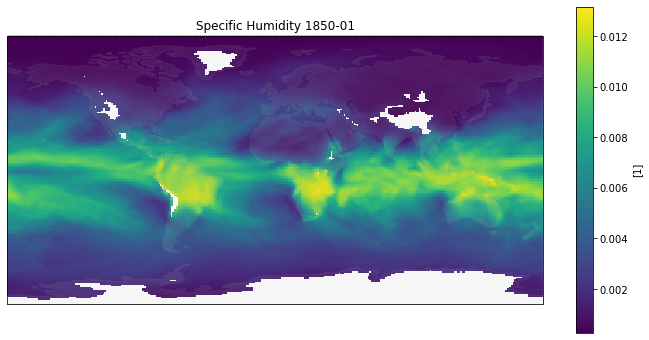

In [36]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'hus', mod_id = 'GFDL-CM4')
plot_year(dset, var_id = 'hus', month = '01', year = '1850', layer = 2)

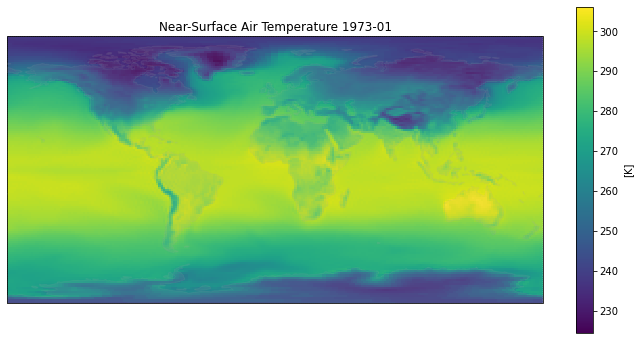

In [37]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'tas', mod_id = 'CNRM-CM6-1')
plot_year(dset, var_id = 'tas', month = '01', year = '1973')

Plotting atmospheric air temperature

In [ ]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'ta', mod_id = 'CNRM-CM6-1')
plot_year(dset, var_id = 'ta', month = '01', year = '1942', layer = 5)

In [ ]:
dset = get_cmpi6_model_run(data_store = col, var_id = 'cl', mod_id = 'CNRM-CM6-1')
dset
#plot_year(dset, var_id = 'cl', month = '01', year = '1850', layer = 5)

In [ ]:
# Change source model by specifying it here
source = "GFDL-CM4"
# Querying to get Near Surface Air Temperature ('tas')
query_variable_id = dict(
    experiment_id=['historical'],
    #institution_id = "CCCma",
    source_id = source,
    table_id = ['Amon'],
    variable_id=['tas'])

col_var_subset = col.search(**query_variable_id)

In [ ]:
col_var_subset

In [ ]:
# Getting the member number for the first experiment
tas_member = col_var_subset.df['member_id'][0]
tas_member

In [ ]:
# Checking query worked
col_var_subset.df

In [ ]:
tas_filename =col_var_subset.df.query("member_id==@tas_member")['zstore'].iloc[0]
tas_filename

In [ ]:
# Unpacking 
dset_cccma_tas=xr.open_zarr(fsspec.get_mapper(tas_filename), consolidated=True)
dset_cccma_tas

In [ ]:
# Specifying a year and month to select by with xarray
# TODO: Find more elegant solution, probably something with cftime\
Year = '2000'
Month = '07'
start_date = Year + '-' + Month + '-' + '01'
end_date = Year + '-' + Month + '-' + '30'

In [ ]:
tas_lon = dset_cccma_tas.lon
tas_lat = dset_cccma_tas.lat
# Indexing for a particular month. Plotting code get upset if we don't index here.
tas_data = dset_cccma_tas['tas'].sel(time=slice(start_date, end_date))[0,:,:]

In [ ]:
tas_data

In [ ]:
f, ax = plt.subplots(1,1,figsize=(12,12),
                     subplot_kw=dict(projection=ccrs.PlateCarree()))

p = ax.pcolormesh(tas_lon,
              tas_lat,
              tas_data,
              transform=ccrs.PlateCarree())

f.colorbar(p, label='Temp (Kelvin)', shrink = .5)
ax.set_title('Global Temperatures' )

# Add land.
ax.add_feature(cfeature.LAND, color='#a9a9a9', zorder=4);

In [ ]:
tas_data_df = tas_data.to_dataframe().reset_index()
tas_data_df

## First show all 40 CCCma historical runs

In [ ]:
source = "CanESM5"
query = dict(
    experiment_id=['historical'],
    institution_id = "CCCma",
    source_id = source,
    table_id=["SImon"],
    variable_id=['sithick'])

col_subset = col.search(require_all_on=["source_id"],**query)

In [ ]:
col_subset.df.head()

In [ ]:
len(col_subset.df)

## get the first realization for the sithick dataset

In [ ]:
filename=col_subset.df.query("member_id=='r1i1p2f1'")['zstore'].iloc[0]

In [ ]:
member = 'r7i1p2f1'

Get the first realization for the Near Surface Air Temperature

## Now get the cell area for the ocean grid

In [ ]:
query = dict(
    experiment_id=['historical'],
    institution_id = "CCCma",
    table_id = "Ofx",
    source_id = source,
    member_id = member,
    variable_id=['areacello'])

col_subset = col.search(require_all_on=["source_id"],**query)
col_subset.df

Getting the cell area for the atmospheric grid

In [ ]:
query = dict(
    experiment_id=['historical'],
    institution_id = "CCCma",
    table_id = "fx",
    source_id = source,
    member_id = tas_member,
    variable_id=['areacella'])

tas_col_subset = col.search(require_all_on=["source_id"],**query)
tas_col_subset.df

In [ ]:
tas_grid_filename=tas_col_subset.df['zstore'].iloc[0]
tas_grid_filename

In [ ]:
dset_cccma_areacello=xr.open_zarr(fsspec.get_mapper(filename), consolidated=True)
dset_cccma_areacello

In [ ]:
dset_cccma_areacella=xr.open_zarr(fsspec.get_mapper(tas_grid_filename), consolidated=True)
dset_cccma_areacello

In [ ]:
dset_cccma_areacello['sithick']

## Plot the lat/lon for this curvilinear ocean grid

In [ ]:
lons = dset_cccma_sithick.longitude
lats = dset_cccma_sithick.latitude
data = dset_cccma_sithick['sithick']

In [ ]:
t_lons = dset_cccma_tas.longitude
#t_lats
#t_data 

In [ ]:
lons.shape
lats.shape
data.shape

In [ ]:
plt.plot(lons[-30:],lats[-30:],'r.');

In [ ]:
def deseam(lon, lat, data):
    """
    Function to get rid of the "seam" that shows up on 
    the map when you're using these curvilinear grids.
    """
    i, j = lat.shape
    new_lon = np.zeros((i, j + 1))
    new_lon[:, :-1] = lon
    new_lon[:, -1] = lon[:, 0]

    new_lat = np.zeros((i, j + 1))
    new_lat[:, :-1] = lat
    new_lat[:, -1] = lat[:, 0]

    new_data = np.zeros((i, j + 1))
    new_data[:, :-1] = data
    new_data[:, -1] = data[:, 0]
    new_data = np.ma.array(new_data, mask=np.isnan(new_data))
    return new_lon, new_lat, new_data

In [ ]:
lons, lats, newdata = deseam(lons,lats,data[0,:,:])

## Now do a mean climatology: 1970-2000

In [ ]:
climatology =  dset_cccma_sithick['sithick'].sel(time=slice('1970', '2000'))

In [ ]:
climatology.time

In [ ]:
# Take a seasonal climatology over 1970-2000
climatology = dset_cccma_sithick['sithick'].sel(time=slice('1970', '2000')).groupby('time.season').mean('time')

In [ ]:
JJA = climatology.sel(season='JJA').squeeze()
lons, lats, data = deseam(JJA.longitude, JJA.latitude, JJA)

In [ ]:
f, ax = plt.subplots(1,1,figsize=(12,12),
                     subplot_kw=dict(projection=ccrs.Orthographic(0, 80)))

p = ax.pcolormesh(lons,
              lats,
              data,
              transform=ccrs.PlateCarree(),
              vmin=0, vmax=8, cmap=cm.cm.ice)

f.colorbar(p, label='sea ice thickness (m)')
ax.set_title('CCCma sea ice thickness (m)')

# Add land.
ax.add_feature(cfeature.LAND, color='#a9a9a9', zorder=4);

## Take the area-weighted mean

In [ ]:
dset_cccma_areacello

In [ ]:
areacello = dset_cccma_areacello['areacello'].squeeze()

In [ ]:
sithick = dset_cccma_sithick['sithick'].squeeze()

# Grab north of the equator
arctic_ice = sithick.where(areacello.latitude > 0)
arctic_ice.isel(time=0).plot();
arctic_ice.shape

In [ ]:
areacello.plot();

In [ ]:
# compute area-weighted mean
aw_arctic_ice = (arctic_ice * areacello).sum(['j', 'i']) / areacello.sum()

In [ ]:
aw_arctic_ice = aw_arctic_ice.compute()

In [ ]:
fig, ax = plt.subplots(1,1)
lines = aw_arctic_ice.groupby('time.year').mean('time').plot(ax=ax)
ax.grid(True)

In [ ]:
col_subset.df

In [ ]:
member = 'r30i1p2f1'
filename=col_subset.df.query("member_id=='r30i1p2f1'")['zstore'].iloc[0]
dset_cccma_sithick_r30i1p2f1=xr.open_zarr(fsspec.get_mapper(filename), consolidated=True)
dset_cccma_sithick_r30i1p2f1['sithick']

In [ ]:
dset_cccma_sithick['sithick']

In [ ]:
dset_cccma_sithick['sithick'].values